None


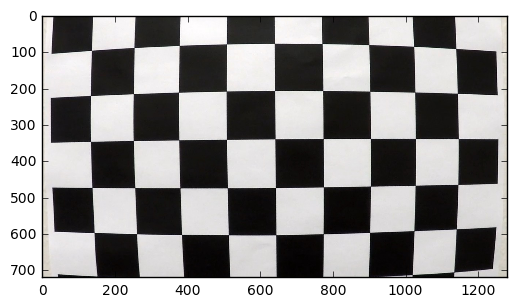

In [8]:
#import numpy as np
#import cv2
#import matplotlib.pyplot as plt
#import matplotlib.image as mpimg



# prepare object points
nx = 9 # enter the number of inside corners in x
ny = 6 # enter the number of inside corners in y
#import PyQt4
import matplotlib
#print(matplotlib.get_backend())
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
#import PyQt4
%matplotlib inline
import glob
import os; 

import random
print(os.environ.get('QT_API'))
img = mpimg.imread('camera_cal/calibration1.jpg')
plt.imshow(img)

objpoints   = []; # 3D points in real world spaces Real chessboard points in 2d plane for 8x6 or whateva size u like. its always same
imgpoints = []; # 2D points in image plane



objp= np.zeros((ny*nx,3),np.float32)
objp[:,:2]=np.mgrid[0:nx,0:ny].T.reshape(-1,2) # x,y coordinates


images=glob.glob('camera_cal/calibration*.jpg')


camera_cal\calibration1.jpg
seraching corner
camera_cal\calibration10.jpg
seraching corner
corners found
camera_cal\calibration11.jpg
seraching corner
corners found
camera_cal\calibration12.jpg
seraching corner
corners found
camera_cal\calibration13.jpg
seraching corner
corners found
camera_cal\calibration14.jpg
seraching corner
corners found
camera_cal\calibration15.jpg
seraching corner
corners found
camera_cal\calibration16.jpg
seraching corner
corners found
camera_cal\calibration17.jpg
seraching corner
corners found
camera_cal\calibration18.jpg
seraching corner
corners found
camera_cal\calibration19.jpg
seraching corner
corners found
camera_cal\calibration2.jpg
seraching corner
corners found
camera_cal\calibration20.jpg
seraching corner
corners found
camera_cal\calibration3.jpg
seraching corner
corners found
camera_cal\calibration4.jpg
seraching corner
camera_cal\calibration5.jpg
seraching corner
camera_cal\calibration6.jpg
seraching corner
corners found
camera_cal\calibration7.jpg


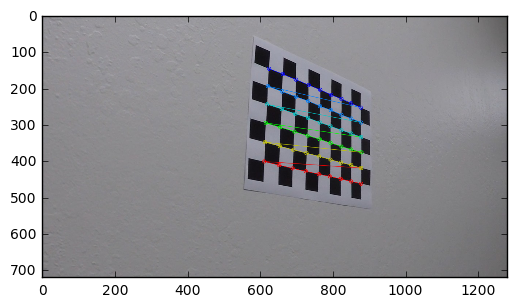

In [9]:
# Gather Calibration values

objp= np.zeros((ny*nx,3),np.float32)
objp[:,:2]=np.mgrid[0:nx,0:ny].T.reshape(-1,2) # x,y coordinates
images=glob.glob('camera_cal/calibration*.jpg')
undists=[]
imags=[]
idx=1
#objpoints=np.array(dtype=float32)
#imgpoints=[]
#print(images)

for fname in images:
    # read in each image
    img=mpimg.imread(fname)
    print(fname)
    # convert image to grayscale
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    # FIND THE CHESSBOARD CORNERS
    ret, corners = cv2.findChessboardCorners(gray,(nx,ny),None)
    print('seraching corner')
    # If corners are found, add object points ,image points
    if ret ==True:
        print('corners found')
        imgpoints.append(corners)
        objpoints.append(objp)
        
        # draw and display the corners
        img = cv2.drawChessboardCorners(img,(nx,ny),corners,ret)
        plt.imshow(img)

In [21]:
# Undistort Images

def cal_undistort(img, objpoints, imgpoints, cal):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret,corners=cv2.findChessboardCorners(gray,(nx,ny),None)
    if ret==True:
        imgpoints.append(corners)
        objpoints.append(objp)
        img=cv2.drawChessboardCorners(img,(nx,ny),corners,ret)
        plt.imshow(img)
    if cal==True:
        ret,mtx,dist,rvecs,tvecs=cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)
        undist=cv2.undistort(img,mtx,dist,None,mtx)
    else:
        undist = np.copy(img)  # Delete this line
    return undist

undists=[]
imags=[]
mtx_arr=[]
dist_arr=[]
for fname in images:
    img=mpimg.imread(fname)
    imags.append(img)
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #ret,mtx,dist,rvecs,tvecs=cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    mtx_arr.append(mtx)
    dist_arr.append(dist)
    undist=cv2.undistort(img,mtx,dist,None,mtx)
    print(fname)
    undists.append(undist)
    

camera_cal\calibration1.jpg
camera_cal\calibration10.jpg
camera_cal\calibration11.jpg
camera_cal\calibration12.jpg
camera_cal\calibration13.jpg
camera_cal\calibration14.jpg
camera_cal\calibration15.jpg
camera_cal\calibration16.jpg
camera_cal\calibration17.jpg
camera_cal\calibration18.jpg
camera_cal\calibration19.jpg
camera_cal\calibration2.jpg
camera_cal\calibration20.jpg
camera_cal\calibration3.jpg
camera_cal\calibration4.jpg
camera_cal\calibration5.jpg
camera_cal\calibration6.jpg
camera_cal\calibration7.jpg
camera_cal\calibration8.jpg
camera_cal\calibration9.jpg


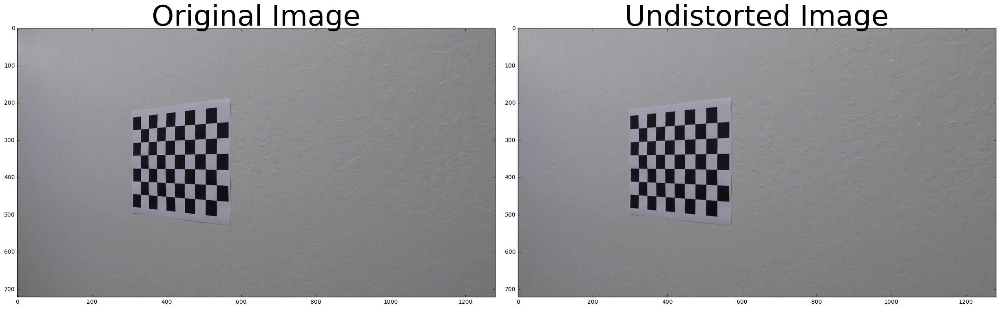

In [4]:
# Undistort Images
rand_idx=random.randint(1,20)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(imags[rand_idx])
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undists[rand_idx])
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

[[ 432.5  119.5]] [[ 946.5612793   121.14746094]] [[ 929.34710693  429.33462524]] [[ 443.5  434.5]]


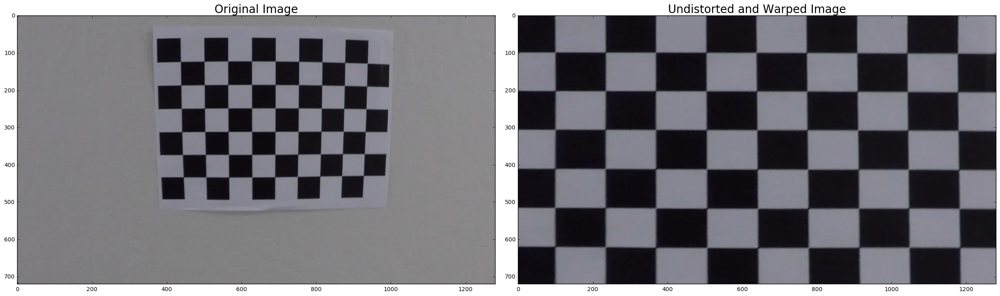

In [22]:
# Perspective Transform

def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    undist=cv2.undistort(img,mtx,dist,None,None)
    gray=cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)
    ret,corners=cv2.findChessboardCorners(gray,(nx,ny),None)
    print(corners[0], corners[nx-1], corners[-1], corners[-nx])
    if ret==True:
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        offset = 100
        img_size = (undist.shape[1], undist.shape[0])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
        [img_size[0]-offset, img_size[1]-offset], 
        [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(undist, M, img_size)
        #print('-1',corners[-1])
        #print(corners)
        return warped,M

rand_idx=random.randint(1,15)    
img=imags[rand_idx]

top_down, perspective_M = corners_unwarp(img, nx, ny, mtx_arr[rand_idx], dist_arr[rand_idx])
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [6]:
def abs_sobel_thresh(img, orient='x',sobel_kernel=3, mag_thresh=(0, 255)):
    thresh_min=mag_thresh[0]
    thresh_max=mag_thresh[1]
    gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        sobelx=cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
        abs_sobel=np.absolute(sobelx)
    if orient == 'y':
        sobely=cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
        abs_sobel=np.absolute(sobely)
    scaled_sobel=np.uint8(255*abs_sobel/np.max(abs_sobel))
    sxbinary=np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel>thresh_min)&(scaled_sobel<thresh_max)]=1
    binary_output=sxbinary
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    # 3) Take the absolute value of the derivative or gradient
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

test_images\straight_lines2.jpg


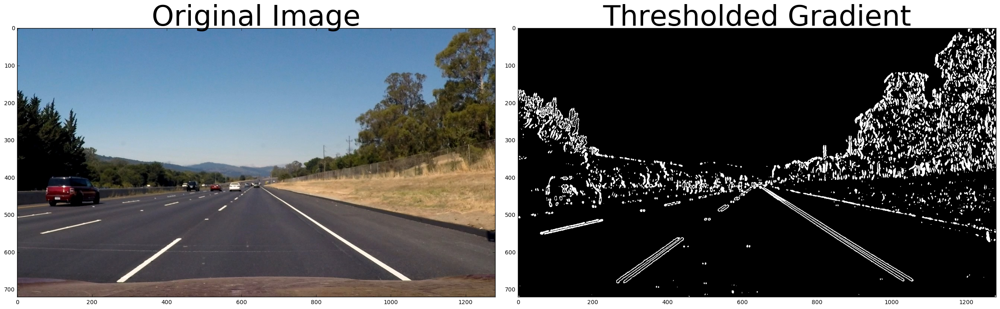

In [7]:
str_images=glob.glob('test_images/straight_lines*.jpg')


rand_idx=random.randint(0,1)  
print(str_images[rand_idx])

image=mpimg.imread(str_images[rand_idx])
grad_binary = abs_sobel_thresh(image, orient='x',sobel_kernel=15, mag_thresh=(20,100) )
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\straight_lines2.jpg


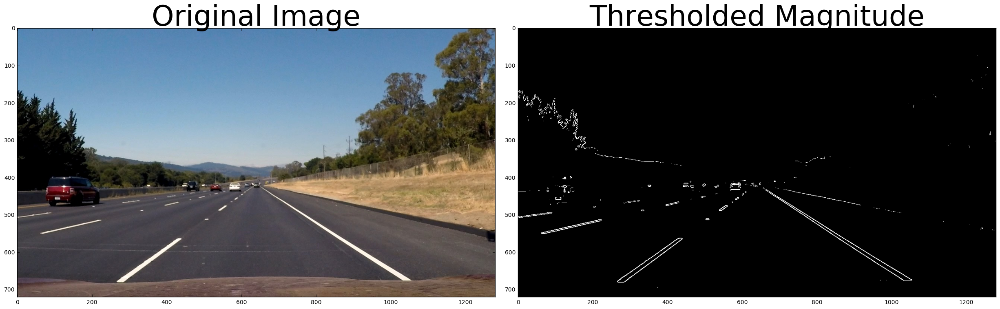

In [8]:
str_images=glob.glob('test_images/straight_lines*.jpg')


rand_idx=random.randint(0,1)  
print(str_images[rand_idx])

image=mpimg.imread(str_images[rand_idx])


def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output
    
# Run the function
mag_binary = mag_thresh(image, sobel_kernel=3, mag_thresh=(100, 250))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\straight_lines1.jpg


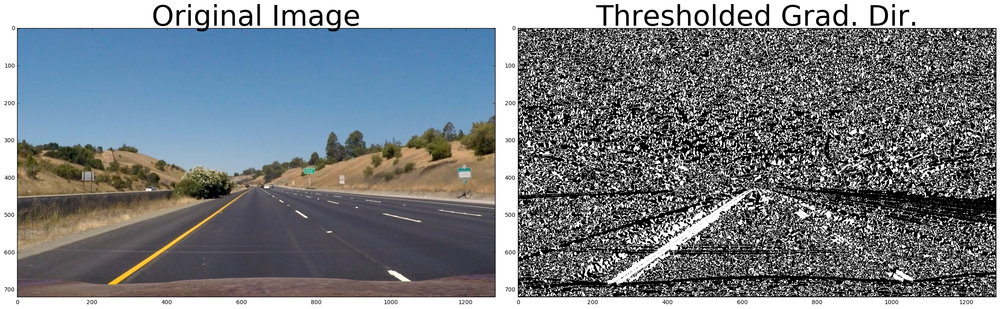

In [9]:
str_images=glob.glob('test_images/straight_lines*.jpg')


rand_idx=random.randint(0,1)  
print(str_images[rand_idx])

image=mpimg.imread(str_images[rand_idx])


def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1    
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    # 5) Create a binary mask where direction thresholds are met
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output
    
# Run the function
dir_binary = dir_threshold(image, sobel_kernel=17, thresh=(0.6, 1.2))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\straight_lines2.jpg


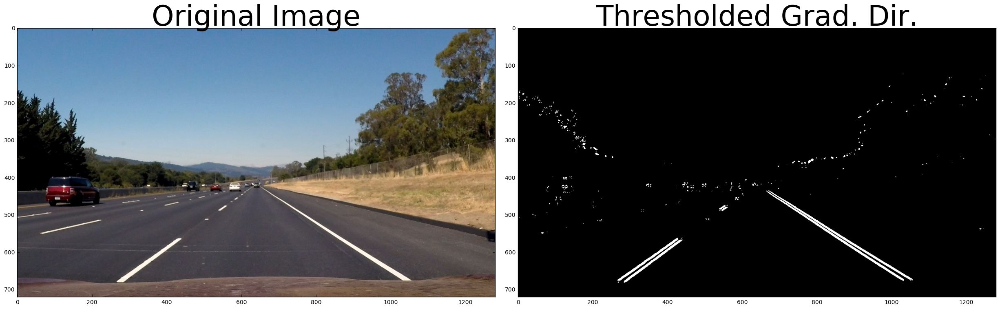

In [10]:
str_images=glob.glob('test_images/straight_lines*.jpg')


rand_idx=random.randint(0,1)  
print(str_images[rand_idx])

image=mpimg.imread(str_images[rand_idx])



# Choose a Sobel kernel size
ksize = 17 # Choose a larger odd number to smooth gradient measurements



# Apply each of the thresholding functions
gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, mag_thresh=(50, 110))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, mag_thresh=(50, 110))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(100, 250))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.2))


combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1



#plt.imshow(combined, cmap='gray')

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

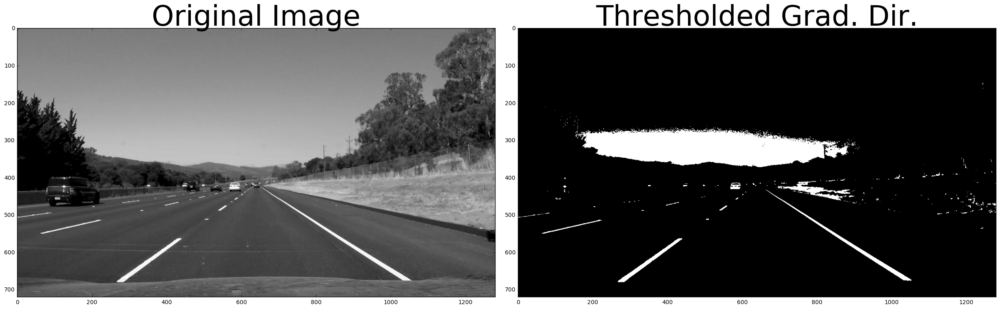

In [11]:

# Color Space

image = mpimg.imread(str_images[rand_idx])
thresh = (180, 255)
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
binary = np.zeros_like(gray)
binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1



# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(gray, cmap='gray')
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

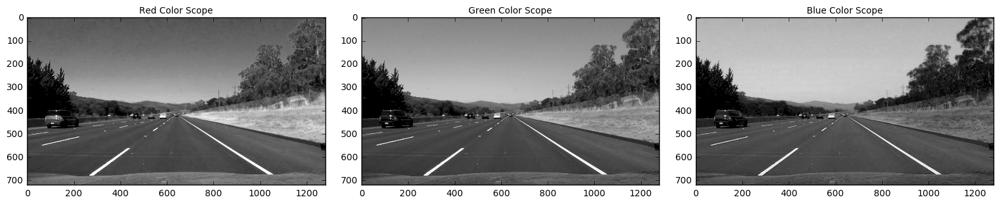

In [12]:

R = image[:,:,0]
G = image[:,:,1]
B = image[:,:,2]

# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 6))
f.tight_layout()
ax1.imshow(R, cmap='gray')
ax1.set_title('Red Color Scope', fontsize=10)
ax2.imshow(G, cmap='gray')
ax2.set_title('Green Color Scope', fontsize=10)
ax3.imshow(B, cmap='gray')
ax3.set_title('Blue Color Scope', fontsize=10)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


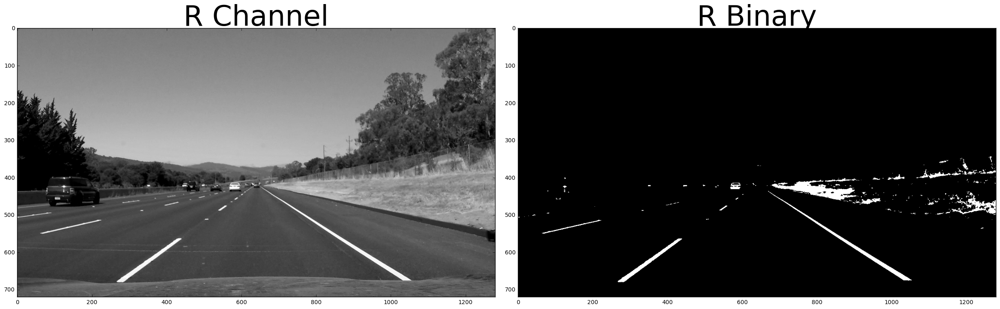

In [13]:
# R channel seems promising

thresh = (200, 255)
binary = np.zeros_like(R)
binary[(R > thresh[0]) & (R <= thresh[1])] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(gray, cmap='gray')
ax1.set_title('R Channel', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('R Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

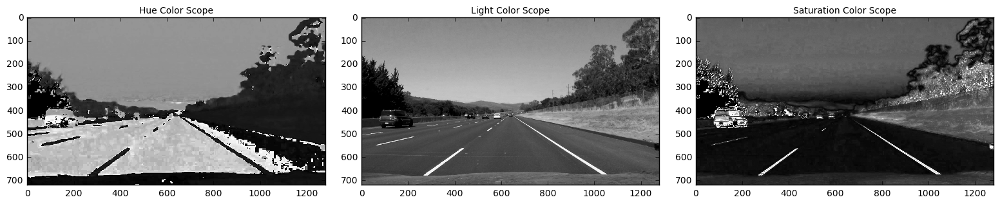

In [14]:
# HLS Color Space

hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]


# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 6))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('Hue Color Scope', fontsize=10)
ax2.imshow(L, cmap='gray')
ax2.set_title('Light Color Scope', fontsize=10)
ax3.imshow(S, cmap='gray')
ax3.set_title('Saturation Color Scope', fontsize=10)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

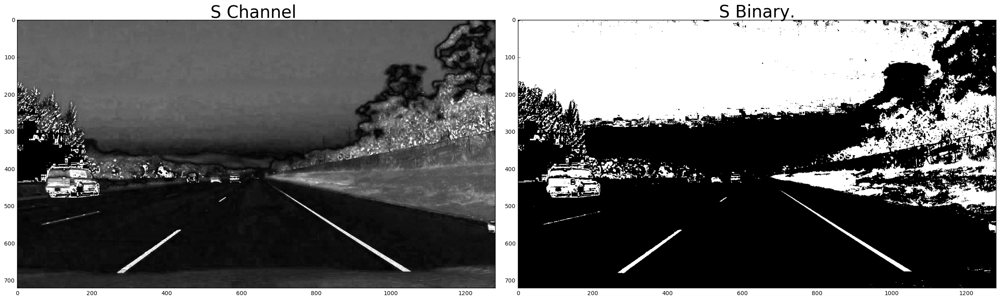

In [15]:
# S seems promising
thresh = (90, 255)
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1



# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(S, cmap='gray')
ax1.set_title('S Channel ', fontsize=30)
ax2.imshow(binary, cmap='gray')
ax2.set_title('S Binary.', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\straight_lines1.jpg


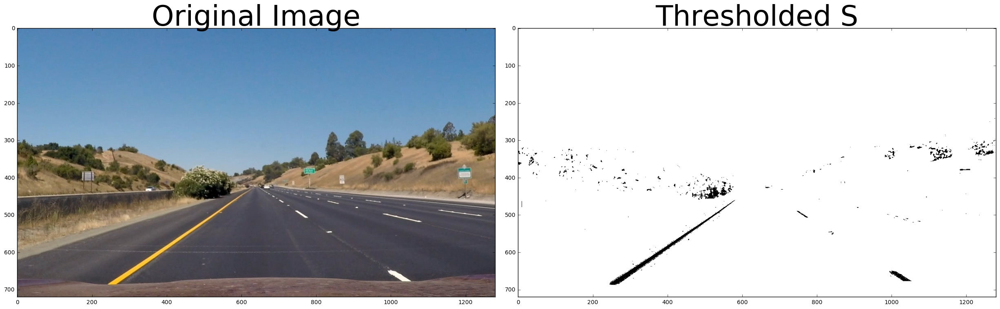

In [11]:
str_images=glob.glob('test_images/straight_lines*.jpg')


rand_idx=random.randint(0,1)  
print(str_images[rand_idx])

image=mpimg.imread(str_images[rand_idx])



# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    # 2) Apply a threshold to the S channel
    # 3) Return a binary image of threshold result
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    #binary_output = np.copy(img) # placeholder line
    return binary_output
    
hls_binary = hls_select(image, thresh=(0, 150))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

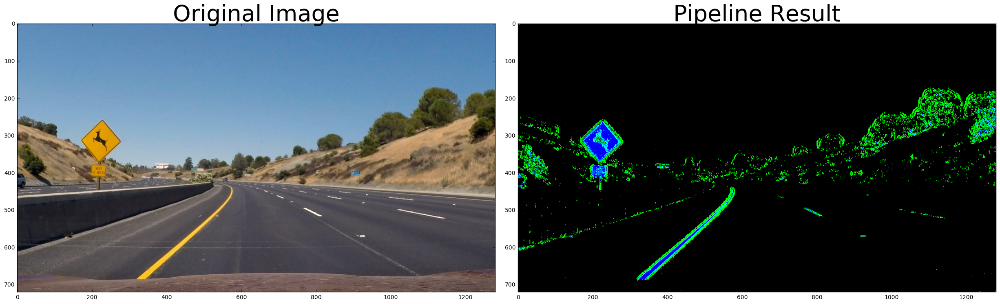

In [212]:
# Convert to HLS color space and separate the S channel
# Note: img is the undistorted image
img=image


def pipeline(img, s_thresh=(170, 255), sx_thresh=(15, 100)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary
    
result = pipeline(image)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(result)
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [14]:
# Calibrate the camera
rd_imgs=[]
r_mtx_arr=[]
r_dist_arr=[]
rd_undists=[]

for fname in str_images:
    img=mpimg.imread(fname)
    rd_imgs.append(img)
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #ret,mtx,dist,rvecs,tvecs=cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    r_mtx_arr.append(mtx)
    r_dist_arr.append(dist)
    undist=cv2.undistort(img,mtx,dist,None,mtx)
    print(fname)
    rd_undists.append(undist)

test_images\straight_lines1.jpg
test_images\straight_lines2.jpg


In [53]:
# Looking at the image
import matplotlib.pyplot as plt
#interactive(True)
%matplotlib qt

plt.imshow(rd_undists[1])

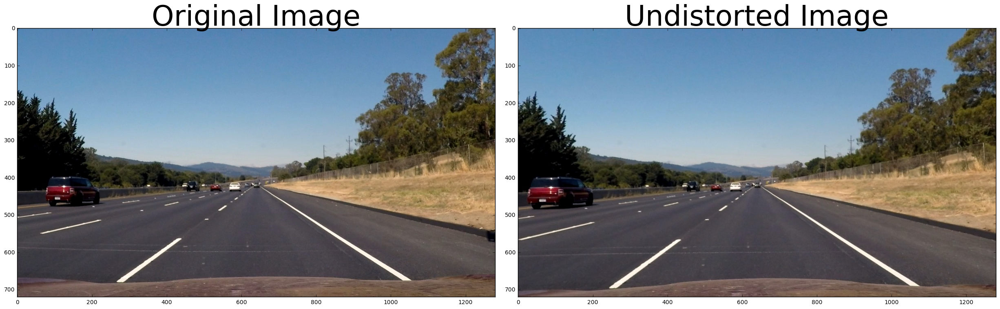

In [16]:
# Displaying undistorted images

# Undistort Images
rand_idx=random.randint(0,1)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(rd_imgs[rand_idx])
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(rd_undists[rand_idx])
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

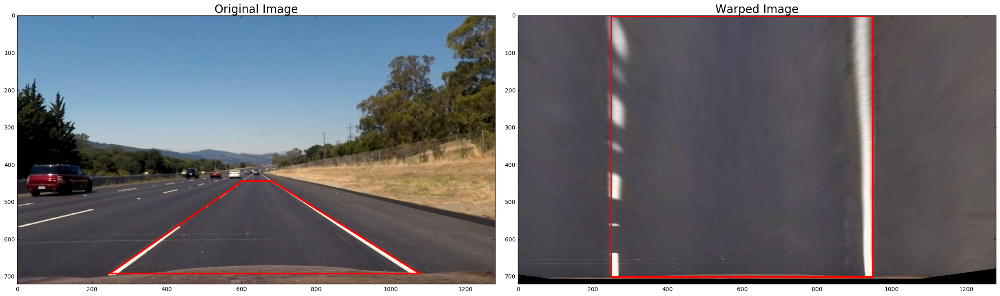

In [385]:
# perspective transform of road
import matplotlib.patches as patches
#topL=[623.469,425.699]
#topR=[660.199,425.699]
topL=[602.145, 443.433]
topR=[681.948, 443.433]
bottomL=[247.022, 691.62]
bottomR=[1076.97, 691.62]
%matplotlib inline

def persp_trans(undist):
    src = np.float32([topL, topR, bottomR, bottomL])
    offset = 200
    img_size = (undist.shape[1], undist.shape[0])
    #dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
    #[img_size[0]-offset, img_size[1]-offset], 
    #[offset, img_size[1]-offset]])
    
    dst1=np.float32([[250,0],[950,0],[950,700],[250,700]])
    #print(dst1)
    M = cv2.getPerspectiveTransform(src, dst1)
    warped = cv2.warpPerspective(undist, M, img_size)
    return warped

wrpdimg=persp_trans(rd_undists[1])

undist=rd_undists[1]
offset = 200
img_size = (undist.shape[1], undist.shape[0])

dst1=np.float32([[250,0],[950,0],[950,700],[250,700]])


f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(rd_undists[1])
ax1.set_title('Original Image', fontsize=20)
ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))
#ax1.plot(topL, topR)# bottomR, bottomL])
ax2.imshow(wrpdimg)
ax2.set_title('Warped Image', fontsize=20)
ax2.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#ax1.Polygon([topL, topR, bottomR, bottomL])


test_images\test3.jpg


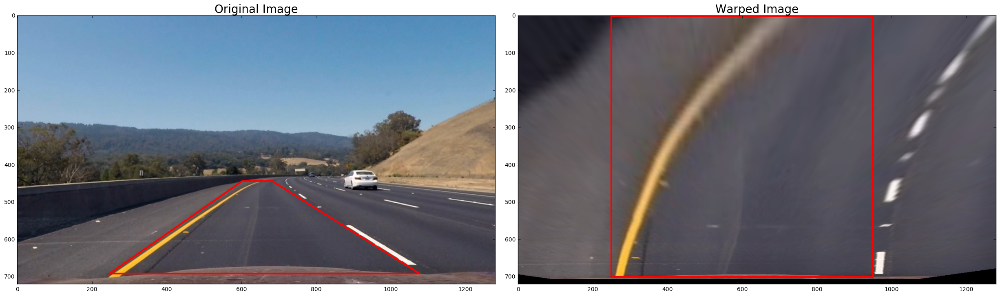

In [390]:
# Combining two process for curved images

tst_images=glob.glob('test_images/test*.jpg')


rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])

image=mpimg.imread(tst_images[rand_idx])
def undistort_img(image):
    gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist=cv2.undistort(image,mtx,dist,None,mtx)
    return undist



undist=undistort_img(image)
wrpimg=persp_trans(undist)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist)
ax1.set_title('Original Image', fontsize=20)
ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))
#ax1.plot(topL, topR)# bottomR, bottomL])
ax2.imshow(wrpimg)
ax2.set_title('Warped Image', fontsize=20)
ax2.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\test3.jpg
[[ 250.    0.]
 [ 950.    0.]
 [ 950.  700.]
 [ 250.  700.]]


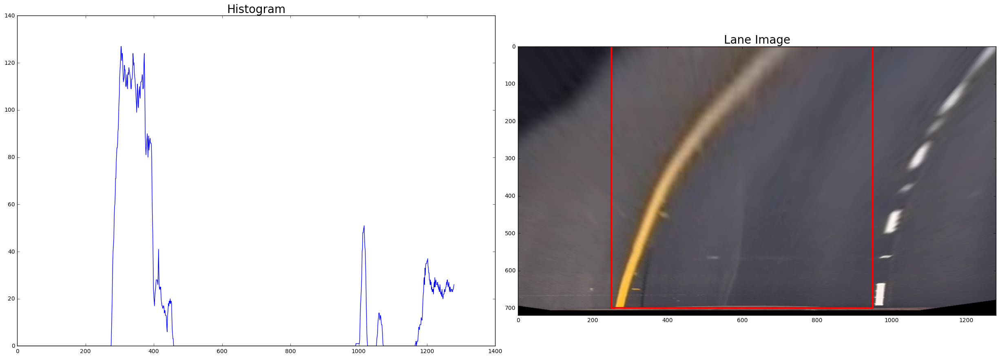

In [301]:
# Plotting histogram of image

tst_images=glob.glob('test_images/test*.jpg')

rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])


undist=undistort_img(image)
wrpimg=persp_trans(undist)
#pimage=pipeline(wrpimg)

#pmanip_img=pimage[:,:,2]

#binary = np.zeros_like(pmanip_img)
#binary[(pimage[:,:,2] == 1) | (pimage[:,:,1] == 1)] = 1

#histogram = np.sum(binary[binary.shape[0]//2:,:], axis=0)
#plt.plot(histogram)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.plot(histogram)
ax1.set_title('Histogram', fontsize=20)
ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))
#ax1.plot(topL, topR)# bottomR, bottomL])
ax2.imshow(wrpimg)
ax2.set_title('Lane Image', fontsize=20)
ax2.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

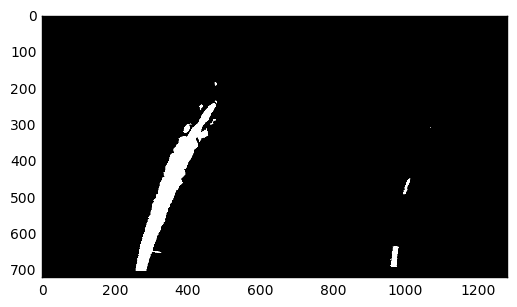

In [303]:
hls = cv2.cvtColor(wrpimg, cv2.COLOR_RGB2HLS)
#hls=pimage
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
thresh = (70, 255)
#print(np.min(S))
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1

plt.imshow(binary,cmap='gray')

0
(720, 1280, 3)


C:\Users\anish_4s67ibh\Anaconda2\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:23: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


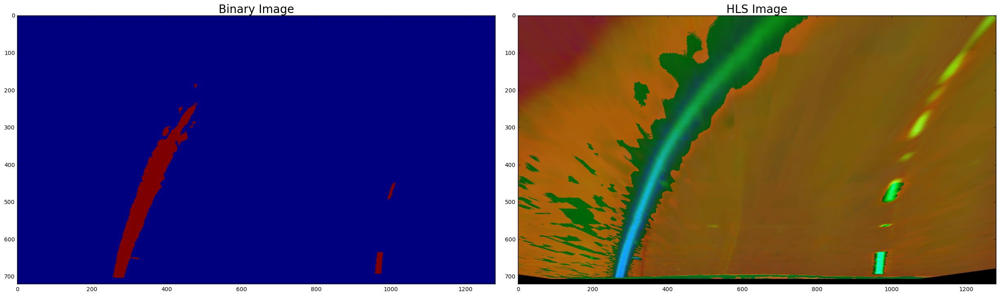

In [304]:

print(binary[250][700])
print(pimage.shape)

pmanip_img=pmanip_img.astype(int)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(binary)
ax1.set_title('Binary Image', fontsize=20)
#ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))

ax2.imshow(hls)
ax2.set_title('HLS Image', fontsize=20)
#.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



binary_warped=binary
# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

(720, 0)

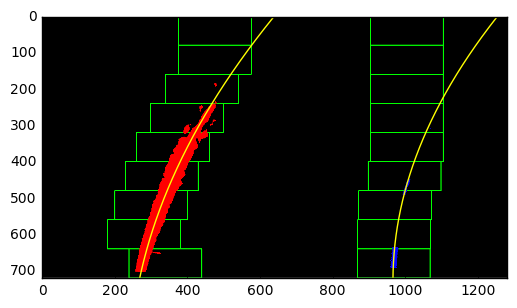

In [305]:
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]

#print(nonzeroy[5])
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [127]:

def pipeline_frame1(image, plot):
    undist=undistort_img(image)
    wrpimg=persp_trans(undist)
    pimage=pipeline(wrpimg)
    pmanip_img=np.square(pimage[:,:,2])

    img=pmanip_img
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    binary_warped=pmanip_img
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    if plot== True:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
    

test_images\test3.jpg
[[ 250.    0.]
 [ 950.    0.]
 [ 950.  700.]
 [ 250.  700.]]


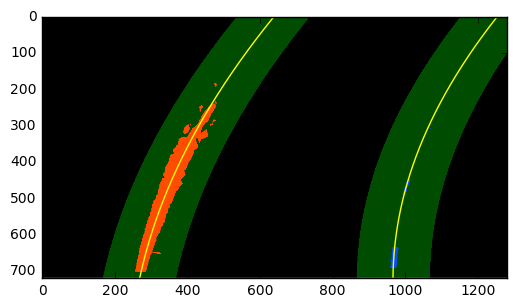

In [306]:
#def pipeline_nextframes(image,plot):

tst_images=glob.glob('test_images/test*.jpg')

rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])
plot=True


undist=undistort_img(image)
wrpimg=persp_trans(undist)
pimage=pipeline(wrpimg)
pmanip_img=np.square(pimage[:,:,2])

hls = cv2.cvtColor(wrpimg, cv2.COLOR_RGB2HLS)
#hls=pimage
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
thresh = (100, 255)
#print(np.min(S))
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1

img=binary
histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
# Assume you now have a new warped binary image 
# from the next frame of video (also called "binary_warped")
# It's now much easier to find line pixels!
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

if plot==True:
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
 


        

In [281]:
def plot2(binary,binTitle,hls,hlsTitle):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary)
    ax1.set_title(binTitle, fontsize=20)
    #ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))

    ax2.imshow(hls)
    ax2.set_title(hlsTitle, fontsize=20)
    #.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_images\test4.jpg
[[ 250.    0.]
 [ 950.    0.]
 [ 950.  700.]
 [ 250.  700.]]


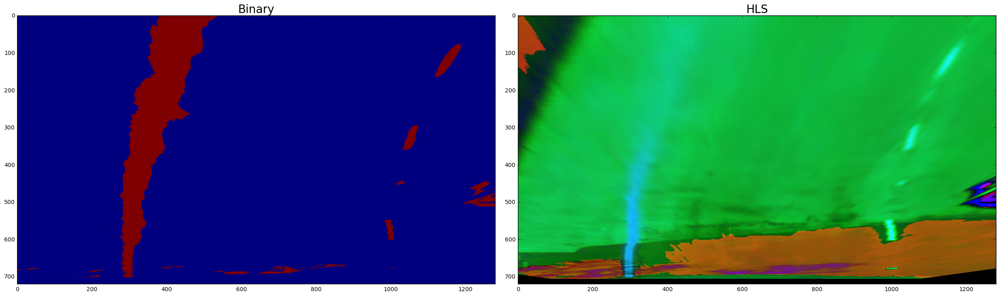

In [282]:

tst_images=glob.glob('test_images/test*.jpg')

rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])
undist=undistort_img(image)
wrpimg=persp_trans(undist)


hls = cv2.cvtColor(wrpimg, cv2.COLOR_RGB2HLS)
#hls=pimage
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
thresh = (100, 255)
#print(np.min(S))
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1


plot2(binary,'Binary',hls,'HLS')

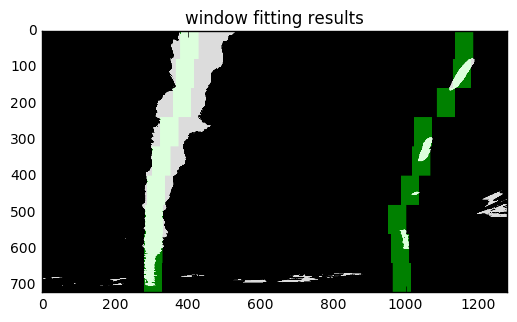

In [285]:

warped=binary*220

# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))
    return window_centroids

window_centroids = find_window_centroids(warped, window_width, window_height, margin)

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
        l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
# If no window centers found, just display orginal road image
else:
    output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

# Display the final results
plt.imshow(output)
plt.title('window fitting results')
plt.show()


In [308]:
# Generate some fake data to represent lane-line pixels
#ploty = np.linspace(0, 719, num=720)# to cover same y-range as image


#quadratic_coeff = 3e-4 # arbitrary quadratic coefficient
# For each y position generate random x position within +/-50 pix
# of the line base position in each case (x=200 for left, and x=900 for right)
#leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
#for y in ploty])
#rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
 #                               for y in ploty])

#leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
#rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


# Fit a second order polynomial to pixel positions in each fake lane line
left_fit = np.polyfit(ploty, leftx, 2)
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fit = np.polyfit(ploty, rightx, 2)
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up the fake data
mark_size = 3
plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, ploty, color='green', linewidth=3)
plt.plot(right_fitx, ploty, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images

TypeError: expected x and y to have same length

In [309]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48

1287.2061684 921.859772297


In [310]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

TypeError: expected x and y to have same length

In [371]:
def img_process(image, thresh_min, thresh_max):
    undist=undistort_img(image)
    wrpimg=persp_trans(undist)
    
    color_bin=pipeline(wrpimg, s_thresh=(130, 255), sx_thresh=(10, 100))
    #plt.imshow(color_bin)
    hls = cv2.cvtColor(wrpimg, cv2.COLOR_RGB2HLS)
    #hls=pimage
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    thresh = (thresh_min, thresh_max)
    #print(np.min(S))
    binary = np.zeros_like(S)
    binary[((S > thresh[0]) & (S <= thresh[1])) | (color_bin[:,:,2]==1 ) |  (color_bin[:,:,1] ==1) ] = 1
    
    #col_s=color_bin[:,:,2]
    #color_bina=np.zeros_like(col_s)
    #color_bina[(color_bin[:,:,2]==1 )| (color_bin[:,:,1] ==1)] =1
    #plt.imshow(color_bina*255)
    #print(np.min(color_bina))
    return binary

#tst_images=glob.glob('test_images/test*.jpg')
#rand_idx=5
#rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
#image=mpimg.imread(tst_images[rand_idx])

#bina=img_process(image,thresh_min,thresh_max)

test_images\test2.jpg


test_images\test5.jpg
test_images\test5.jpg


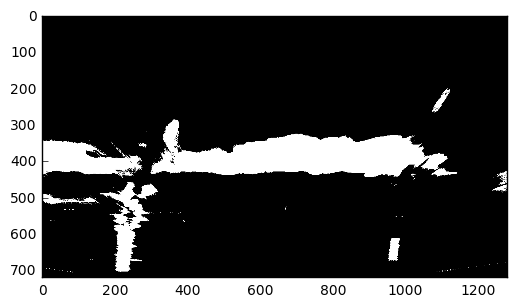

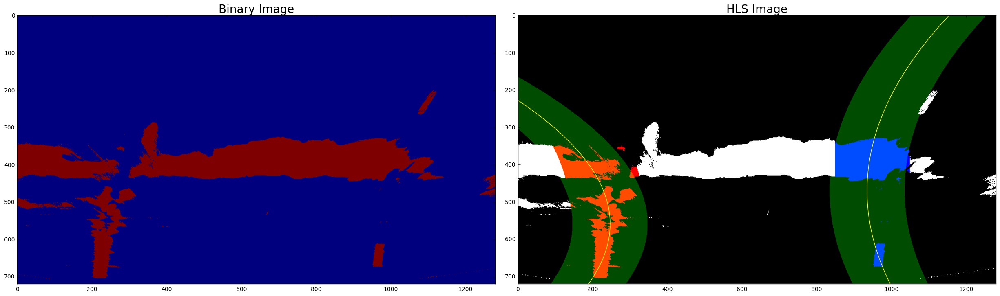

In [387]:
tst_images=glob.glob('test_images/test*.jpg')

rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])

thresh_min=85
thresh_max=255


binary=img_process(image,thresh_min,thresh_max)

plt.imshow(binary,cmap='gray')


# For first frame
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(binary)
ax1.set_title('Binary Image', fontsize=20)
#ax1.add_patch(patches.Polygon((topL, topR, bottomR, bottomL),linewidth=3, color='r', fill=False))

ax2.imshow(hls)
ax2.set_title('HLS Image', fontsize=20)
#.add_patch(patches.Polygon(dst1,linewidth=3, color='r', fill=False))
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



binary_warped=binary
# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)



# After first frame

#tst_images=glob.glob('test_images/test*.jpg')

#rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])
plot=True


binary=img_process(image,thresh_min,thresh_max)

#undist=undistort_img(image)
#wrpimg=persp_trans(undist)
#pimage=pipeline(wrpimg)
#pmanip_img=np.square(pimage[:,:,2])

#hls = cv2.cvtColor(wrpimg, cv2.COLOR_RGB2HLS)
#hls=pimage
#H = hls[:,:,0]
#L = hls[:,:,1]
#S = hls[:,:,2]
#thresh = (thresh_min, thresh_max)
#print(np.min(S))
#binary = np.zeros_like(S)
#binary[(S > thresh[0]) & (S <= thresh[1])] = 1

img=binary
histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
# Assume you now have a new warped binary image 
# from the next frame of video (also called "binary_warped")
# It's now much easier to find line pixels!
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

if plot==True:
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
 



In [373]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48

1469.16155116 876.594999821


In [374]:
print(ploty.shape)
print(leftx.shape)
print(rightx.shape)

# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

(720,)
(41283,)
(3622,)
447.433575638 m 286.761111596 m


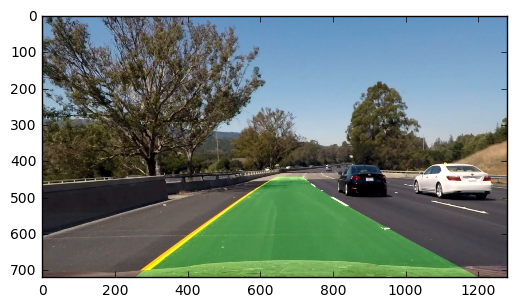

In [375]:

src = np.float32([topL, topR, bottomR, bottomL])
dst1=np.float32([[250,0],[950,0],[950,700],[250,700]])
Minv = cv2.getPerspectiveTransform(dst1, src)

#Crveate an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undistort_img(image), 1, newwarp, 0.3, 0)
plt.imshow(result)

In [400]:
w

In [401]:
tst_images=glob.glob('test_images/test*.jpg')

rand_idx=random.randint(0,5)  
print(tst_images[rand_idx])
image=mpimg.imread(tst_images[rand_idx])
retu=lane_map(image)

test_images\test3.jpg


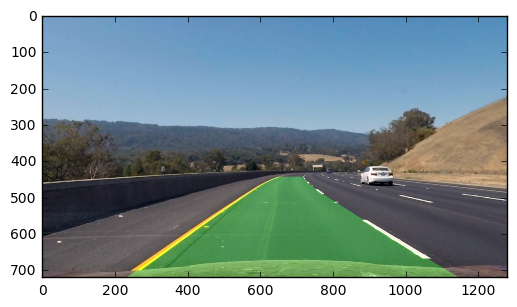

In [402]:
plt.imshow(retu)

In [2]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [406]:
NUM_FRAME=0
lane_map_output = 'project_video_soln.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(lane_map) #NOTE: this function expects color images!!
%time white_clip.write_videofile(lane_map_output, audio=False)

OSError: [WinError 6] The handle is invalid

In [3]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(lane_map_output))

ERROR:root:An unexpected error occurred while tokenizing input
The following traceback may be corrupted or invalid
The error message is: ('EOF in multi-line string', (1, 0))



NameError: name 'lane_map_output' is not defined